In [3]:
#IMPORT all necessary libraries and modules

#add path to sys so that we can import functions from other folders
import sys
import os

sys.path.append(r'C:\Users\tfarotimi\United Nations\Contexto Proyecciones Sector Externo - ProyectoAutomatización\Dev\Inflation Forecasting\lib')

#import libraries 
import pandas as pd
import numpy as np
import plotly.graph_objs as go
import plotly.offline as pyo
from plotly.subplots import make_subplots
pyo.init_notebook_mode()
import nbformat

import matplotlib.pyplot as plt
import seaborn as sns



#tqdm
from tqdm import tqdm

from monthly_forecast_run import run_monthly_forecast
from excel_agg_forecast import create_aggregate_report
from excel_forecast_report import create_forecast_report

from helper_functions import load_data
import pickle



#scikit-learn
#randomforestregessor
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error,r2_score



#statsmodels
from statsmodels.tsa.ar_model import AutoReg
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.vector_ar.var_model import VAR
from statsmodels.tsa.statespace.varmax import VARMAX

from models import arima, sarimax, varmax, var_model
from model_search import run_models

import pmdarima as pm
#from pm.arima import ADFTest


#import functions from modules
from helper_functions import load_data, read_inflation_data, merge_exogenous_data, grangers_causation_matrix, get_best_predictors, run_var_for_all_combos
from dashboard import model_compare, r2_compare, error_compare
from residuals_analysis import analyze_residuals
from forecast import get_forecast 
import armagarch as ag

#import modules
import importlib
import models
import helper_functions
import dashboard
import residuals_analysis
import forecast
import armagarch as ag


#reload modules to ensure that changes made to them are reflected in the notebook
importlib.reload(models)
importlib.reload(helper_functions)
importlib.reload(dashboard)
importlib.reload(residuals_analysis)
importlib.reload(forecast)


%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
from statsmodels.tsa.api import acf, graphics, pacf
from statsmodels.tsa.ar_model import AutoReg, ar_select_order
import datetime as dt

import regex as re

sns.set_style("darkgrid")
pd.plotting.register_matplotlib_converters()
# Default figure size
sns.mpl.rc("figure", figsize=(16, 6))
sns.mpl.rc("font", size=14)

#disable warnings
import warnings
warnings.filterwarnings("ignore")



In [4]:
#ignore warnings
import warnings
warnings.filterwarnings('ignore')


In [5]:
import pandas as pd
#create variables for each file path where data is stored

#file path for inflation data in standardized format in Excel (Nico's table)
INFL_DATA_FILE_NAME = r'dat/2023/October/Inflation_Data_Raw_102023.xlsx'

#file path for Excel file containing exogenous variable data for each country
CHL_EXOG_FILE_NAME = r'dat/2024/January/Banco de Chile Time Series.xlsx'




#call function to read in inflation data and exogenous variable data and save it to a dictionary for each region 
#SUR_data, CEN_data, CAR_data, REG_data = read_inflation_data(INFL_DATA_FILE_NAME)

CHL_data =     df = pd.read_excel(CHL_EXOG_FILE_NAME, sheet_name = 'CPI')
#set index
CHL_data.set_index('Period', inplace = True)



In [6]:
#RESAMPLE chl_data_iter_2 to quarterly data
# CHL_data = SUR_data['CHL']

#read sheet names from CHL-EXOG_FILE_NAME
sheet_names = pd.ExcelFile(CHL_EXOG_FILE_NAME).sheet_names


for sheet in sheet_names[1:]: 

    df = pd.read_excel(CHL_EXOG_FILE_NAME, sheet_name = sheet)
        
    #set index to Period'
    df.set_index('Period', inplace = True)
    #convert index to datetime
    df.index = pd.to_datetime(df.index)
    
    if 'raw' in sheet:
        #get percent change from same period last year
        df = df.pct_change(12)
        df = df.dropna()

    if 'quarterly' in sheet:
        df = df.resample('MS').interpolate(method='linear')

    #merge exogenous variable data with inflation data
    CHL_data = pd.merge(CHL_data, df, how = 'left', left_index = True, right_index = True)
    
    
CHL_data = CHL_data

CHL_data.tail()

#show missing values as heatmap
#sns.heatmap(CHL_data.isnull(), cbar=False)


,YoY Increase Inflation,Deposit Interest Rates - 30 to 90 days - Nominal,US 10-Year Bond Rates,Monetary Policy Rate,Food Price Index,Nominal Observed Exchange Rate,Real Exchange Rate Index,Expectativas de inflación en 11 meses,Gold Price $ per oz,Copper Price $ per pound,Oil Price $ per barrel,CPI_United States,PPI_United States_Finshed Goods,PPI_China,Economic Activity,General Wage Index,Unemployment Rate,M1 Money Supply
Period,,,,,,,,,,,,,,,,,,
2023-11-01,4.8,8.27,4.492500,9.000000,120.8,886.614286,102.092910,3.3,1985.71,3.707679,77.43,3.1,-3.0,-1.1,112.053880,8.3,8.732412,54190.961398
2023-12-01,3.9,7.89,4.009476,8.723684,119.2,874.665789,100.651301,3.1,2034.84,3.807543,72.08,3.4,-2.7,0.1,117.385659,7.7,8.475639,56193.764761
2024-01-01,3.8,7.41,4.035696,8.250000,117.7,907.986818,103.198361,3.0,2032.19,3.784950,73.93,3.1,-2.5,-0.8,107.473588,6.7,8.400000,56560.280016
2024-02-01,4.5,6.57,4.210952,7.250000,117.0,963.442381,109.330891,3.0,2025.79,3.769727,76.77,3.2,-2.7,1.1,104.185488,6.8,8.500000,56326.248436
2024-03-01,3.7,6.40,4.204143,7.250000,118.3,967.932500,109.889161,3.0,2163.63,3.935240,80.49,3.5,-2.8,1.9,NaN,NaN,8.700000,55523.099043


<AxesSubplot: ylabel='Period'>

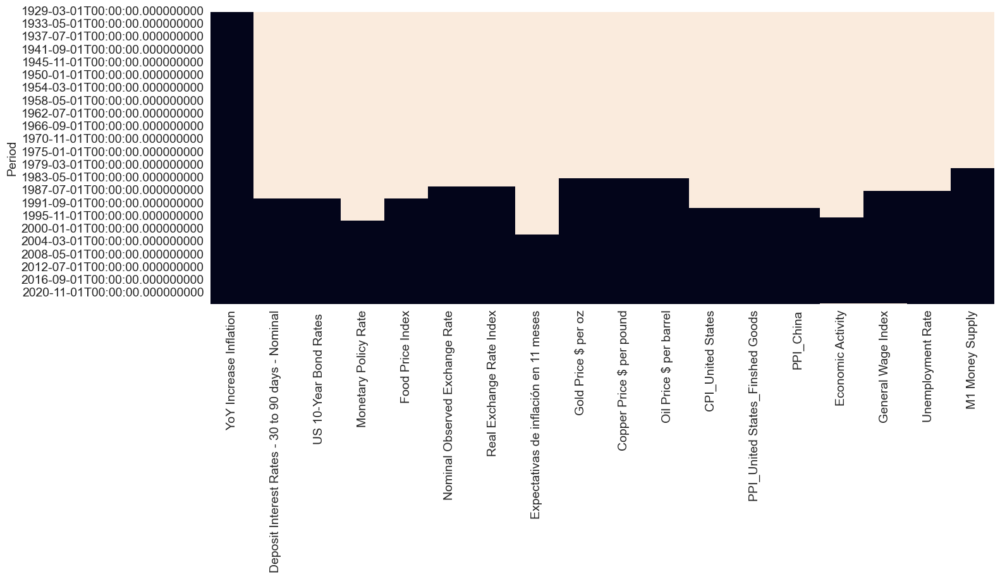

In [7]:





#show missing values as heatmap
sns.heatmap(CHL_data.isnull(), cbar=False)

In [8]:
CHL_data_abridged = CHL_data.dropna()   

In [9]:
CHL_data_abridged.tail()

,YoY Increase Inflation,Deposit Interest Rates - 30 to 90 days - Nominal,US 10-Year Bond Rates,Monetary Policy Rate,Food Price Index,Nominal Observed Exchange Rate,Real Exchange Rate Index,Expectativas de inflación en 11 meses,Gold Price $ per oz,Copper Price $ per pound,Oil Price $ per barrel,CPI_United States,PPI_United States_Finshed Goods,PPI_China,Economic Activity,General Wage Index,Unemployment Rate,M1 Money Supply
Period,,,,,,,,,,,,,,,,,,
2023-10-01,5.0,8.64,4.799136,9.450000,120.9,926.347000,105.747030,3.4,1916.59,3.601406,85.57,3.2,-2.6,-0.4,108.096280,8.7,8.886469,54695.188522
2023-11-01,4.8,8.27,4.492500,9.000000,120.8,886.614286,102.092910,3.3,1985.71,3.707679,77.43,3.1,-3.0,-1.1,112.053880,8.3,8.732412,54190.961398
2023-12-01,3.9,7.89,4.009476,8.723684,119.2,874.665789,100.651301,3.1,2034.84,3.807543,72.08,3.4,-2.7,0.1,117.385659,7.7,8.475639,56193.764761
2024-01-01,3.8,7.41,4.035696,8.250000,117.7,907.986818,103.198361,3.0,2032.19,3.784950,73.93,3.1,-2.5,-0.8,107.473588,6.7,8.400000,56560.280016
2024-02-01,4.5,6.57,4.210952,7.250000,117.0,963.442381,109.330891,3.0,2025.79,3.769727,76.77,3.2,-2.7,1.1,104.185488,6.8,8.500000,56326.248436


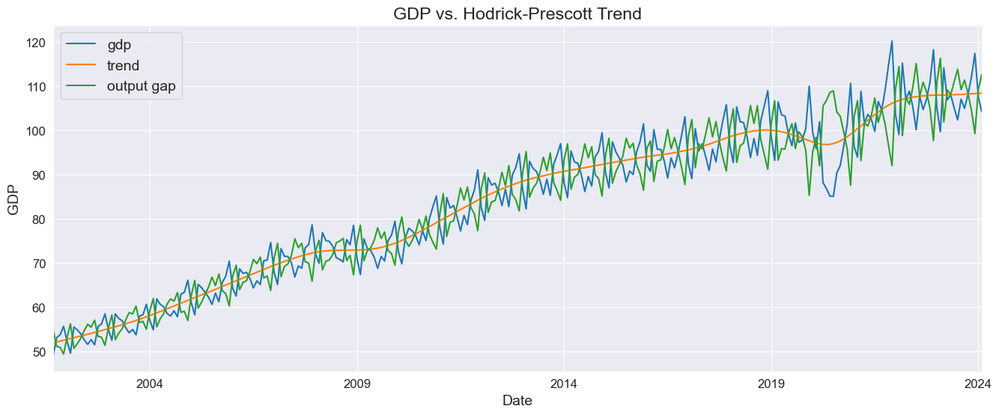

In [10]:
import statsmodels.api as sm
import pandas as pd

# Load your GDP data (replace this with your actual data)
# Assuming you have a DataFrame with a 'date' column and a 'gdp' column
# Example:
# df = pd.read_csv('your_gdp_data.csv')
# df['date'] = pd.to_datetime(df['date'])
# df.set_index('date', inplace=True)

# Apply the Hodrick-Prescott filter
cycle, trend = sm.tsa.filters.hpfilter(CHL_data_abridged['Economic Activity'], lamb=1600)

# Create a new DataFrame to store the results
gdp_decomp = pd.DataFrame({'gdp': CHL_data_abridged['Economic Activity'], 'cycle': cycle, 'trend': trend, 'output gap': trend - cycle})

# Plot the trend and actual GDP
import matplotlib.pyplot as plt
fig, ax = plt.subplots()
gdp_decomp[['gdp', 'trend','output gap']].plot(ax=ax, fontsize=12)
plt.xlabel('Date')
plt.ylabel('GDP')
plt.title('GDP vs. Hodrick-Prescott Trend')
plt.show()

CHL_data_abridged['Output Gap'] = gdp_decomp['output gap']

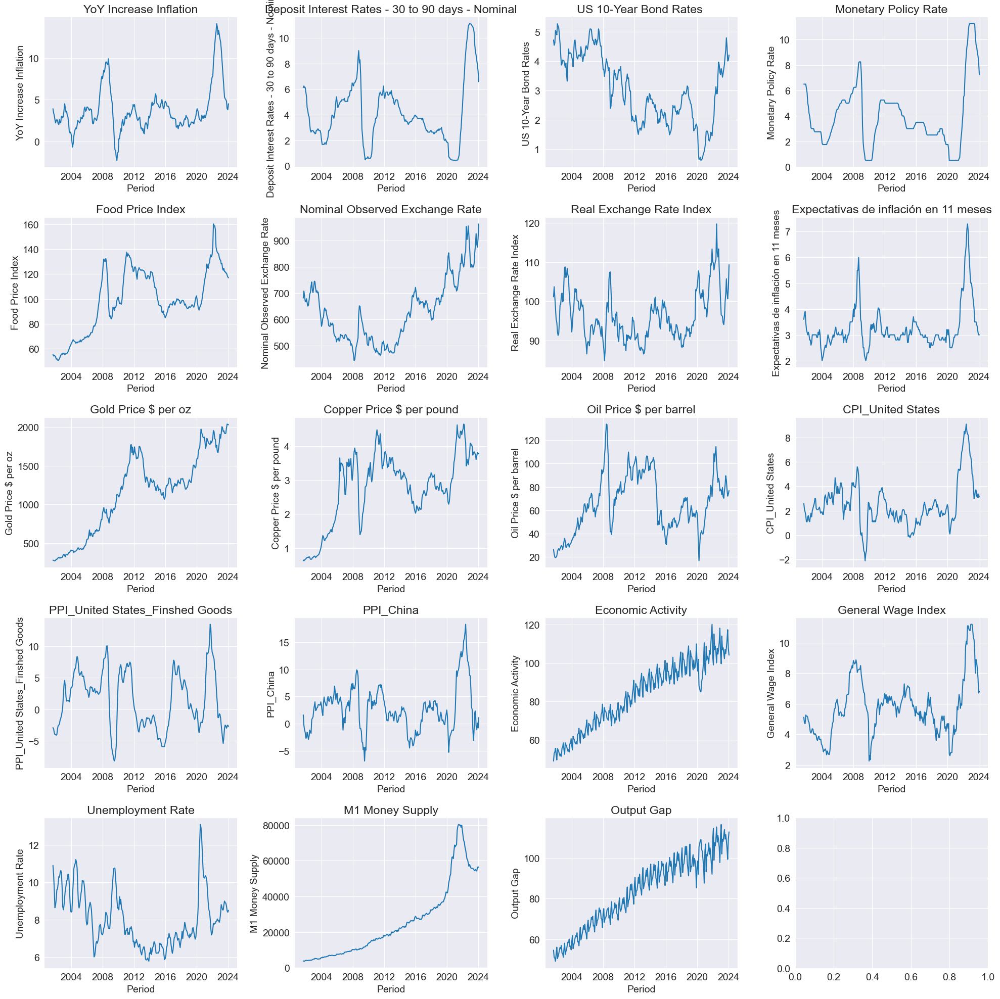

In [11]:
#PLOT ALL 17 COLUMNS IN CHL_DATA_ABRIDGED IN grid
fig, axes = plt.subplots(5, 4, figsize=(20, 20))
axes = axes.flatten()
for i, col in enumerate(CHL_data_abridged.columns):
    sns.lineplot(data=CHL_data_abridged[col], ax=axes[i])
    axes[i].set_title(col)
plt.tight_layout()
plt.show()




In [12]:

#drop remove columns
paper_vars = CHL_data_abridged.columns

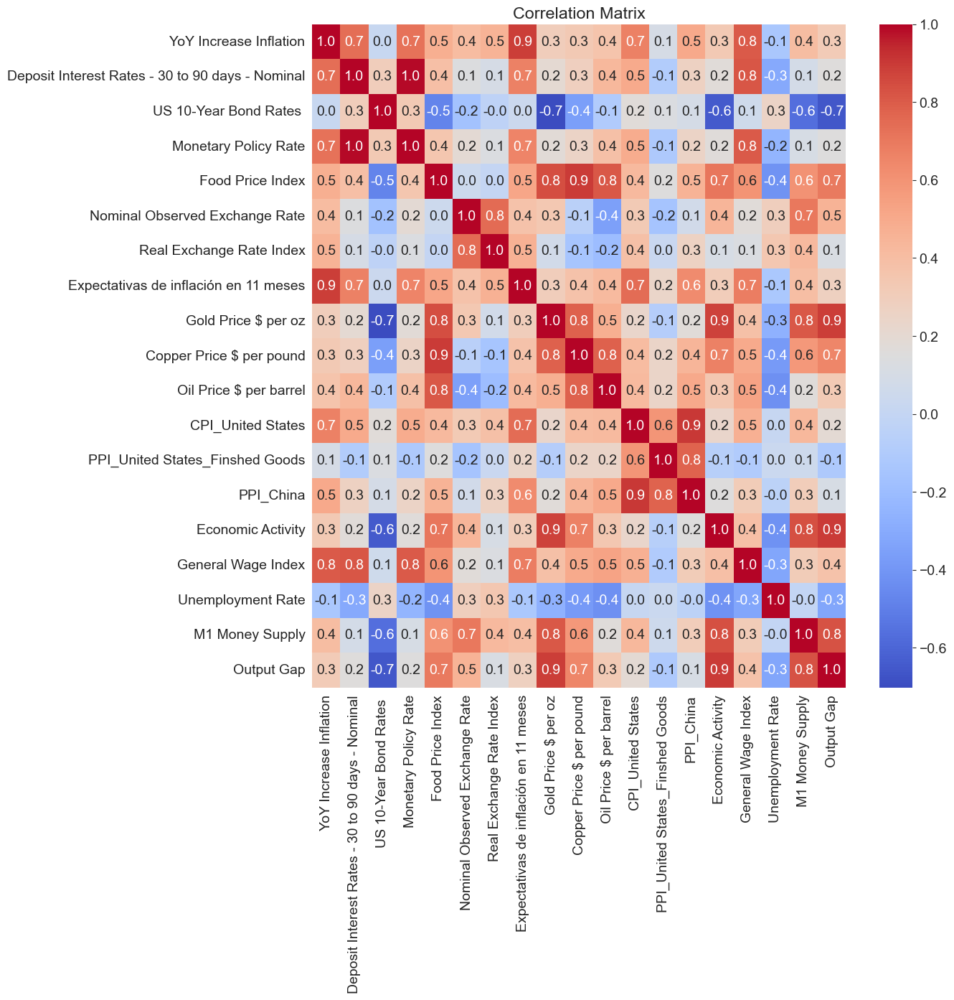

In [13]:
#heatmap of correlation matrix
plt.figure(figsize = (12,12))
sns.heatmap(CHL_data_abridged.corr(), annot = True, cmap = 'coolwarm', fmt = '.1f')
plt.title('Correlation Matrix')
plt.show()

In [14]:

best_combo = ['YoY Increase Inflation', 'US 10-Year Bond Rates ', 'CPI_United States', 'M1 Money Supply']

paper_vars = [
       'Deposit Interest Rates - 30 to 90 days - Nominal',
       'US 10-Year Bond Rates ', 
       'Oil Price $ per barrel',
       'Food Price Index',
       'Nominal Observed Exchange Rate',
       'Expectativas de inflación en 11 meses', 
       'CPI_United States', 'PPI_United States_Finshed Goods',
       'Economic Activity']


#set remainder to each column in CHL_data_abridged thats not in paper_vars
remainder = [col for col in CHL_data_abridged.columns if col not in paper_vars]
remainder.remove('YoY Increase Inflation')

final_vars = ['YoY Increase Inflation', 'CPI_United States','Oil Price $ per barrel','Economic Activity', 'M1 Money Supply','Deposit Interest Rates - 30 to 90 days - Nominal','Nominal Observed Exchange Rate']


francisco_vars = ['Monetary Policy Rate', 'Output Gap', 'Real Exchange Rate Index', 'YoY Increase Inflation']


In [15]:
irf_list = []
fecv_list = []
for var in paper_vars:
    cols = ['YoY Increase Inflation', var]
    G = run_monthly_forecast(var_model,{'CHL_best_var': CHL_data_abridged[cols]},[],log_transform = False, walkforward = False)
    irf_list.append(G[0]['irf'])
    fecv_list.append(G[0]['fecv'])

  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


100%|██████████| 1/1 [00:03<00:00,  3.03s/it]


In [16]:
#plot each impulse response function in irf_list in a grid
import math 

#fig, axes = plt.subplots(int(math.sqrt(len(paper_vars))), int(math.sqrt(len(paper_vars))), figsize=(20, 20))
fig_list = []
fig_list.append(irf_list[0].plot_cum_effects(response = 'YoY Increase Inflation', impulse = 'YoY Increase Inflation'))
for i, irf in enumerate(irf_list):
    fig_list.append(irf.plot_cum_effects(response = 'YoY Increase Inflation', impulse = paper_vars[i]))

#close all plots  
plt.close('all')

#insert 'YoY Increase Inflation' at the beginning of paper_vars
paper_vars.insert(0, 'YoY Increase Inflation')


#plot each impulse response function in fig_list in a grid
#set size of fig object
fig, axes = plt.subplots(3, 4, figsize=(30, 30))
#set title size
plt.rcParams.update({'axes.titlesize': 'large'})
axes = axes.flatten()
plt.rc('font', size=20)  
for i, fig in enumerate(fig_list):
#plot fig in axes[i]
    fig.savefig(f'irf_{i}.png')
    axes[i].imshow(plt.imread(f'irf_{i}.png'))
    axes[i].axis('off')
    axes[i].set_title(paper_vars[i])

#REMOVE empty plots
for i in range(len(paper_vars), len(axes)):
    axes[i].axis('off')

plt.tight_layout()
#fig.show()

In [27]:
irf_list2 = []
fecv_list = []
for var in remainder:
    cols = ['YoY Increase Inflation', var]
    G = run_monthly_forecast(var_model,{'CHL_best_var': CHL_data_abridged[cols]},[],log_transform = False, walkforward = False)
    irf_list2.append(G[0]['irf'])
    fecv_list.append(G[0]['fecv'])

  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


100%|██████████| 1/1 [00:01<00:00,  1.48s/it]


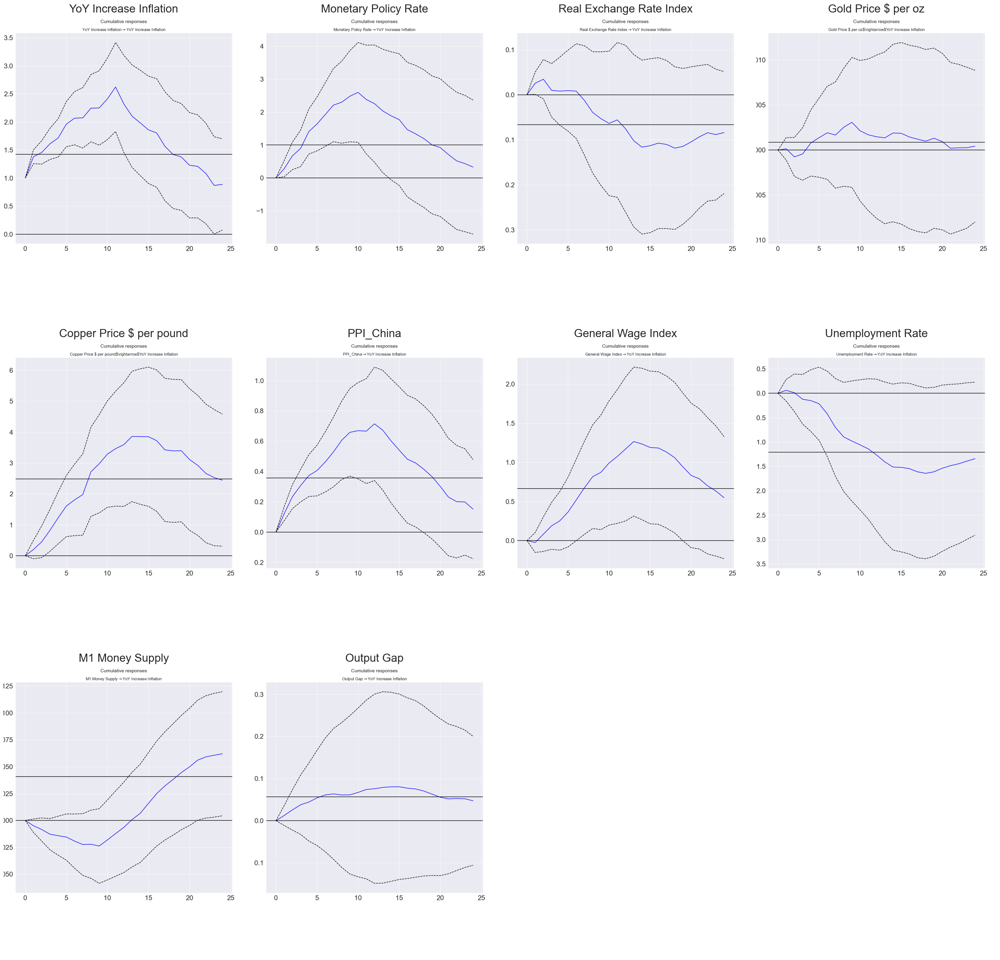

In [28]:
#plot each impulse response function in irf_list in a grid
import math 

#fig, axes = plt.subplots(int(math.sqrt(len(paper_vars))), int(math.sqrt(len(paper_vars))), figsize=(20, 20))
fig_list = []
fig_list.append(irf_list2[0].plot_cum_effects(response = 'YoY Increase Inflation', impulse = 'YoY Increase Inflation'))
for i, irf in enumerate(irf_list2):
    fig_list.append(irf.plot_cum_effects(response = 'YoY Increase Inflation', impulse = remainder[i]))

#close all plots  
plt.close('all')

#insert 'YoY Increase Inflation' at the beginning of paper_vars
remainder.insert(0, 'YoY Increase Inflation')


#plot each impulse response function in fig_list in a grid
#set size of fig object
fig, axes = plt.subplots(3, 4, figsize=(30, 30))
#set title size
plt.rcParams.update({'axes.titlesize': 'large'})
axes = axes.flatten()
plt.rc('font', size=20)  
for i, fig in enumerate(fig_list):
#plot fig in axes[i]
    fig.savefig(f'irf_{i}.png')
    axes[i].imshow(plt.imread(f'irf_{i}.png'))
    axes[i].axis('off')
    axes[i].set_title(remainder[i])

#REMOVE empty plots
for i in range(len(remainder), len(axes)):
    axes[i].axis('off')

plt.tight_layout()
#fig.show()

In [38]:
francisco_vars

['YoY Increase Inflation',
 'Monetary Policy Rate',
 'Output Gap',
 'Real Exchange Rate Index',
 'YoY Increase Inflation']

In [2]:


# G[0]['irf'].plot_cum_effects(orth = True, impulse = 'PPI_United States_Finshed Goods', response = 'Economic Activity')
# G[0]['irf'].plot_cum_effects(orth = True, impulse = 'Economic Activity', response = 'M1 Money Supply')
# G[0]['irf'].plot_cum_effects(orth = True, impulse = 'M1 Money Supply', response = 'Nominal Observed Exchange Rate')
# G[0]['irf'].plot_cum_effects(orth = True, impulse = 'Nominal Observed Exchange Rate', response = 'YoY Increase Inflation')


final_vars = ['PPI_United States_Finshed Goods', 'Economic Activity', 'M1 Money Supply', 'Nominal Observed Exchange Rate', 'YoY Increase Inflation']





In [114]:
#plot each column in CHL_data_abridged[final_vars']
fig, axes = plt.subplots(3, 2, figsize=(20, 20))
axes = axes.flatten()
for i, col in enumerate(final_vars):
    sns.lineplot(data=CHL_data_abridged[col].diff(), ax=axes[i])
    axes[i].set_title(col)

In [120]:
final_vars = final_vars[:-1]

In [ ]:
#plot each 

In [117]:
final_vars.remove(final_vars[1])

In [124]:
best_combo = ['YoY Increase Inflation','CPI_United States', 'US 10-Year Bond Rates ', 'M1 Money Supply']

G = create_forecast_report({'CHL_best_var': CHL_data_abridged[best_combo]},[], var_model,log_transform = True, walkforward = False)

  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


100%|██████████| 1/1 [00:01<00:00,  1.53s/it]


In [121]:
H = run_monthly_forecast(var_model, {'CHL_best_var': CHL_data_abridged[final_vars]},[],log_transform = False, walkforward = False)

  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var
Difference the series


100%|██████████| 1/1 [00:00<00:00,  1.56it/s]


In [1]:
#reorder best_combo
#best_combo = ['CPI_United States', 'US 10-Year Bond Rates ', 'M1 Money Supply','YoY Increase Inflation']

H[0]['irf'].plot(orth = True)


NameError: name 'H' is not defined

In [103]:
H[0]['fecv'].summary()

FEVD for YoY Increase Inflation
      YoY Increase Inflation  PPI_United States_Finshed Goods  Economic Activity  M1 Money Supply  Nominal Observed Exchange Rate
0                   1.000000                         0.000000           0.000000         0.000000                        0.000000
1                   0.962811                         0.014208           0.004092         0.013258                        0.005630
2                   0.910039                         0.050759           0.005305         0.026071                        0.007826
3                   0.872229                         0.062208           0.004954         0.040819                        0.019790
4                   0.867838                         0.062420           0.005059         0.042145                        0.022538
5                   0.870302                         0.061310           0.005509         0.040963                        0.021917
6                   0.864428                         0.063

In [ ]:
#plot each impulse response function in irf_list in a grid
import math 

#fig, axes = plt.subplots(int(math.sqrt(len(paper_vars))), int(math.sqrt(len(paper_vars))), figsize=(20, 20))
fig_list = []
fig_list.append(irf_list[0].plot_cum_effects(response = 'YoY Increase Inflation', impulse = 'YoY Increase Inflation'))
for i, irf in enumerate(irf_list):
    fig_list.append(irf.plot_cum_effects(response = 'YoY Increase Inflation', impulse = paper_vars[i]))

#close all plots  
plt.close('all')

#insert 'YoY Increase Inflation' at the beginning of paper_vars
paper_vars.insert(0, 'YoY Increase Inflation')


#plot each impulse response function in fig_list in a grid
#set size of fig object
fig, axes = plt.subplots(3, 4, figsize=(30, 30))
#set title size
plt.rcParams.update({'axes.titlesize': 'large'})
axes = axes.flatten()
plt.rc('font', size=20)  
for i, fig in enumerate(fig_list):
#plot fig in axes[i]
    fig.savefig(f'irf_{i}.png')
    axes[i].imshow(plt.imread(f'irf_{i}.png'))
    axes[i].axis('off')
    axes[i].set_title(paper_vars[i])

#REMOVE empty plots
for i in range(len(paper_vars), len(axes)):
    axes[i].axis('off')

plt.tight_layout()
#fig.show()
























#explain the impulse response function results when orth = True


SyntaxError: unmatched ')' (611428784.py, line 62)

  0%|          | 0/1 [00:00<?, ?it/s]

Training  var_model for  CHL_best_var2
Difference the series


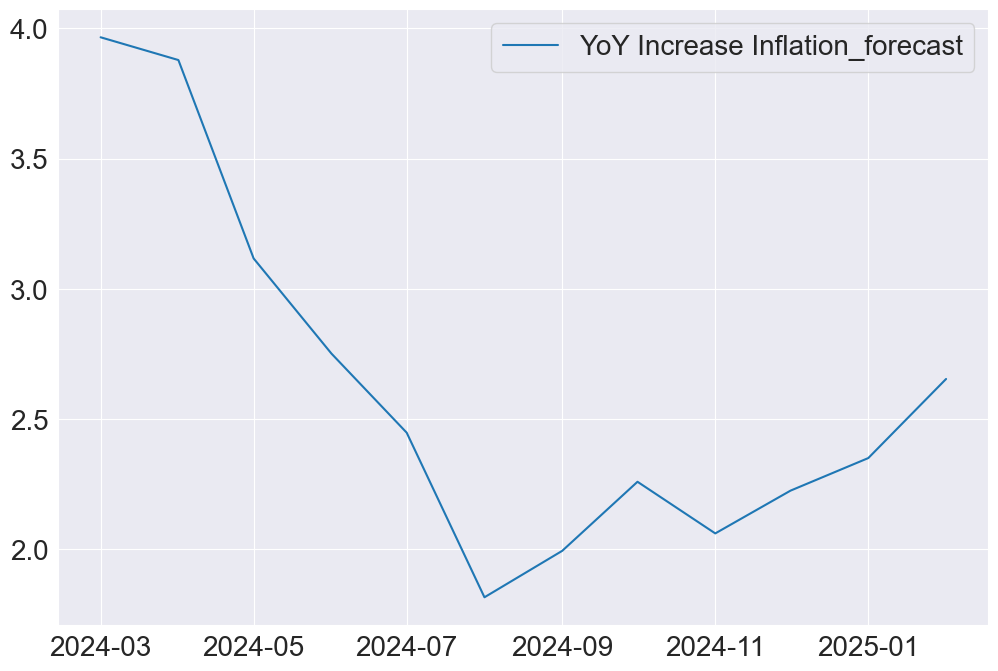

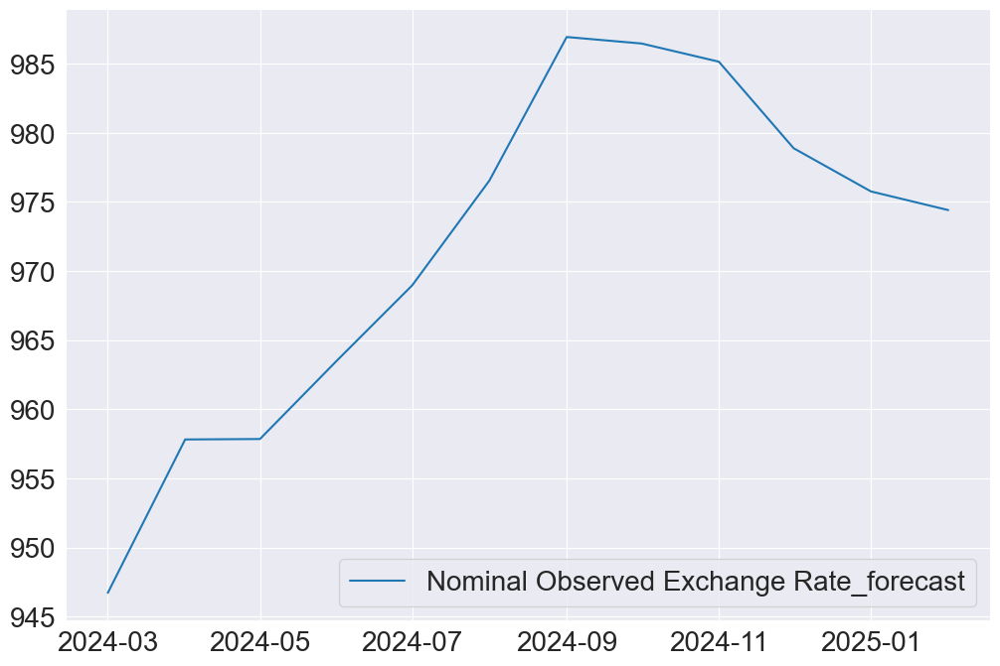

100%|██████████| 1/1 [00:01<00:00,  1.79s/it]


In [ ]:
create_forecast_report({'CHL_best_var2': CHL_data_abridged[['YoY Increase Inflation', 'Nominal Observed Exchange Rate']]},[],var_model, log_transform = False, walkforward = False)

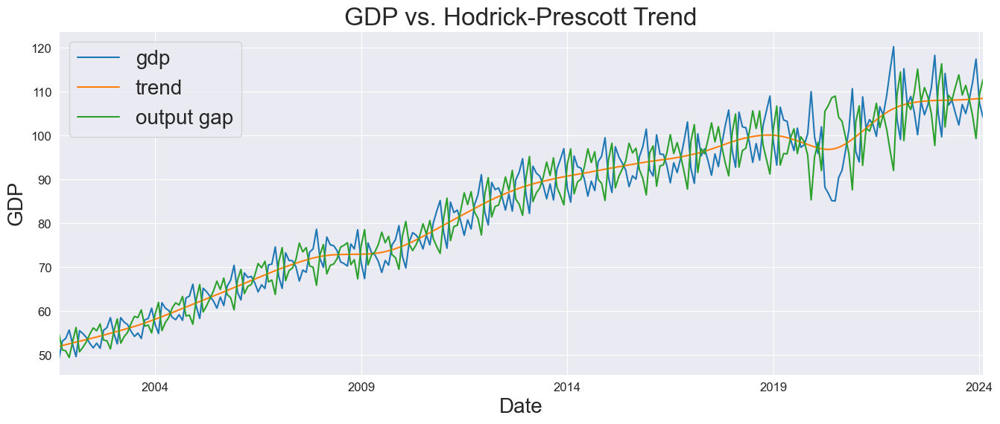

In [ ]:
#heatmap of correlation of CHL_data_abrid